In [0]:
!curl -O https://eqhck20storage.blob.core.windows.net/weather-data/weather_forecast_utc.csv
!curl -O https://eqhck20storage.blob.core.windows.net/main-task/data.2018-10-31.93b9dcde-5e2e-11ea-8d9e-000d3a64d565.csv
# !curl -O https://eqhck20storage.blob.core.windows.net/main-task/running_plan.2018-10-31.93b9dcde-5e2e-11ea-8d9e-000d3a64d565.csv

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 1250M  100 1250M    0     0  6443k      0  0:03:18  0:03:18 --:--:-- 6036k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 99.6M  100 99.6M    0     0  5050k      0  0:00:20  0:00:20 --:--:-- 5950k


In [0]:
!pip install -U pandas missingno tqdm lightgbm sklearn

     |████████████████████████████████| 10.1MB 2.6MB/s 
Requirement already up-to-date: missingno in /usr/local/lib/python3.6/dist-packages (0.4.2)
     |████████████████████████████████| 61kB 8.3MB/s 
     |████████████████████████████████| 1.2MB 52.4MB/s 
Requirement already up-to-date: sklearn in /usr/local/lib/python3.6/dist-packages (0.0)
ERROR: google-colab 1.0.0 has requirement pandas~=0.25.0; python_version >= "3.0", but you'll have pandas 1.0.1 which is incompatible.
  Found existing installation: pandas 0.25.3
    Uninstalling pandas-0.25.3:
      Successfully uninstalled pandas-0.25.3
  Found existing installation: tqdm 4.28.1
    Uninstalling tqdm-4.28.1:
      Successfully uninstalled tqdm-4.28.1
  Found existing installation: lightgbm 2.2.3
    Uninstalling lightgbm-2.2.3:
      Successfully uninstalled lightgbm-2.2.3


In [0]:
import pandas as pd

In [0]:
weather = pd.read_csv("weather_forecast_utc.csv", parse_dates=[1, 2, 3])
# Do initial filtering
# weather = weather[weather["windpark_zone"] == "WP"]
print("[DONE] Weather")
data = pd.read_csv("data.2018-10-31.93b9dcde-5e2e-11ea-8d9e-000d3a64d565.csv", parse_dates=[1])
print("[DONE] Data")

[DONE] Weather
[DONE] Data


In [0]:
!curl -O https://eqhck20storage.blob.core.windows.net/main-task/data.2018-12-17.9d6e35ac-5e2e-11ea-be42-000d3a64d565.csv
data = data.append(pd.read_csv("data.2018-12-17.9d6e35ac-5e2e-11ea-be42-000d3a64d565.csv", parse_dates=[1]))
!curl -O  https://eqhck20storage.blob.core.windows.net/main-task/data.2019-01-06.9ff41cb8-5e2e-11ea-8351-000d3a64d565.csv
data = data.append(pd.read_csv("data.2019-01-06.9ff41cb8-5e2e-11ea-8351-000d3a64d565.csv", parse_dates=[1]))
!curl -O  https://eqhck20storage.blob.core.windows.net/main-task/data.2019-02-21.a11718a4-5e2e-11ea-815b-000d3a64d565.csv
data = data.append(pd.read_csv("data.2019-02-21.a11718a4-5e2e-11ea-815b-000d3a64d565.csv", parse_dates=[1]))
!curl -O https://eqhck20storage.blob.core.windows.net/main-task/data.2019-03-09.a36e93ba-5e2e-11ea-916d-000d3a64d565.csv
data = data.append(pd.read_csv("data.2019-03-09.a36e93ba-5e2e-11ea-916d-000d3a64d565.csv", parse_dates=[1]))
!curl -O  https://eqhck20storage.blob.core.windows.net/main-task/data.2019-04-23.a45c8efe-5e2e-11ea-b199-000d3a64d565.csv
data = data.append(pd.read_csv('data.2019-04-23.a45c8efe-5e2e-11ea-b199-000d3a64d565.csv', parse_dates=[1]))
!curl -O https://eqhck20storage.blob.core.windows.net/main-task/running_plan.2019-04-23.a45c8efe-5e2e-11ea-b199-000d3a64d565.csv
plan = pd.read_csv("running_plan.2019-04-23.a45c8efe-5e2e-11ea-b199-000d3a64d565.csv", parse_dates=[1])

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 26.2M  100 26.2M    0     0  2166k      0  0:00:12  0:00:12 --:--:-- 2416k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 10.8M  100 10.8M    0     0  1836k      0  0:00:06  0:00:06 --:--:-- 2488k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 25.3M  100 25.3M    0     0  2976k      0  0:00:08  0:00:08 --:--:-- 5031k
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 9051k  100 9051k    0     0  1474k      0  0:00:06  0:00:06 --:--:-- 2139k
  % Total    % Received % Xferd  Average Speed   Tim

In [0]:
# Fix weather
weather_copy = weather.groupby(["datetime_start_utc", "windpark_zone"]).last()
weather_copy.loc[:,"SUB_AIR_PRESSURE"] = weather_copy["SUB_AIR_PRESSURE"].apply(lambda it: it if type(it) == float else float(it.replace(",", ".")))
weather_copy.loc[:,"SUB_HOR_VISIBILITY"] = weather_copy["SUB_HOR_VISIBILITY"].apply(lambda it: it if type(it) == float else float(it.replace(",", ".")))
weather_copy.reset_index(inplace=True)
weather_copy.rename(columns={"datetime_start_utc": "timestamp"}, inplace=True)
weather_copy.set_index("timestamp", inplace=True)

In [0]:
from tqdm import notebook

da = {}

for value in weather_copy["windpark_zone"].unique():
  renames = {}
  data_sdsfadas = weather_copy[weather_copy["windpark_zone"] == value]
  for column in notebook.tqdm([col for col in weather_copy.columns if col.upper() == col]):
    name = value + "_" + column
    da[name] = data_sdsfadas[column]

da

start_times = pd.DataFrame(da)

In [0]:
# Fix data
data.set_index("timestamp", inplace=True)

In [0]:
# Merge data and weather 
df = pd.merge(data, start_times, on="timestamp", how="left")

In [0]:
print(start_times.index.unique())
print(data.index.unique())

DatetimeIndex(['2018-04-30 02:00:00+00:00', '2018-04-30 03:00:00+00:00',
               '2018-04-30 04:00:00+00:00', '2018-04-30 05:00:00+00:00',
               '2018-04-30 06:00:00+00:00', '2018-04-30 07:00:00+00:00',
               '2018-04-30 08:00:00+00:00', '2018-04-30 09:00:00+00:00',
               '2018-04-30 10:00:00+00:00', '2018-04-30 11:00:00+00:00',
               ...
               '2019-06-05 03:00:00+00:00', '2019-06-05 04:00:00+00:00',
               '2019-06-05 05:00:00+00:00', '2019-06-05 06:00:00+00:00',
               '2019-06-05 07:00:00+00:00', '2019-06-05 08:00:00+00:00',
               '2019-06-05 09:00:00+00:00', '2019-06-05 10:00:00+00:00',
               '2019-06-05 11:00:00+00:00', '2019-06-05 12:00:00+00:00'],
              dtype='datetime64[ns, UTC]', name='timestamp', length=9635, freq=None)
DatetimeIndex(['2018-05-01 15:00:00+00:00', '2018-05-01 16:00:00+00:00',
               '2018-05-01 17:00:00+00:00', '2018-05-01 18:00:00+00:00',
               '201

In [0]:
import missingno as msn

#msn.matrix()

# remove nan
df = df.dropna(subset=[col for col in df.columns if col.upper() == col])

df.sort_values("timestamp", inplace=True)

In [0]:
from sklearn.model_selection import train_test_split

def build_dataset(df_, wind=False, labels=True):
  df_subset = df_[[col for col in df_.columns if col in ("StateRun", "ActivePowerLimit", "turbine") or col.upper() == col]]
  df_subset["hour"] = df_subset.index.hour
  df_subset['turbine'] = pd.Categorical(df_subset['turbine'], categories=df_subset['turbine'].unique()).codes
  X = df_subset \
        .interpolate("linear") \
        .fillna(method="bfill")
  y = None
  if labels:
    y = df_[[f"{'WindSpeed' if wind else 'ActivePower'} (Average)"]].interpolate("linear").fillna(method="bfill")
  return X, y

X, y = build_dataset(df, wind=False)

X_train, X_test, y_train, y_test = train_test_split(X, y.values.flatten(), test_size=0.016, random_state=42, shuffle=False)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [0]:
import lightgbm as lgb

train_data = lgb.Dataset(X_train, label=y_train)
validation_data = lgb.Dataset(X_test, label=y_test)

In [0]:
param = {'objective': 'regression_l1', "num_leaves": 20_000, "num_estimators": 10_000, "max_depth": 120, "max_bin": 1000, "early_stopping_round": 30}
param['metric'] = 'l1'

bst = lgb.train(param, train_data, 1000, valid_sets=[validation_data])

/usr/local/lib/python3.6/dist-packages/lightgbm/engine.py:153: UserWarning: Found `early_stopping_round` in params. Will use it instead of argument
  warnings.warn("Found `{}` in params. Will use it instead of argument".format(alias))


[1]	valid_0's l1: 1336.79
Training until validation scores don't improve for 30 rounds
[2]	valid_0's l1: 1213.26
[3]	valid_0's l1: 1104.35
[4]	valid_0's l1: 1006.45
[5]	valid_0's l1: 917.092
[6]	valid_0's l1: 841.258
[7]	valid_0's l1: 772.241
[8]	valid_0's l1: 712.643
[9]	valid_0's l1: 661.307
[10]	valid_0's l1: 615.228
[11]	valid_0's l1: 571.771
[12]	valid_0's l1: 533.398
[13]	valid_0's l1: 500.654
[14]	valid_0's l1: 470.833
[15]	valid_0's l1: 443.991
[16]	valid_0's l1: 420.446
[17]	valid_0's l1: 399.774
[18]	valid_0's l1: 380.946
[19]	valid_0's l1: 364.351
[20]	valid_0's l1: 350.29
[21]	valid_0's l1: 337.094
[22]	valid_0's l1: 326.375
[23]	valid_0's l1: 315.894
[24]	valid_0's l1: 307.33
[25]	valid_0's l1: 298.905
[26]	valid_0's l1: 291.801
[27]	valid_0's l1: 285.289
[28]	valid_0's l1: 280.244
[29]	valid_0's l1: 275.494
[30]	valid_0's l1: 271.444
[31]	valid_0's l1: 267.749
[32]	valid_0's l1: 264.206
[33]	valid_0's l1: 260.86
[34]	valid_0's l1: 257.881
[35]	valid_0's l1: 255.467
[36]	v

In [0]:
import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=list(range(len(X_train))),
    y=bst.predict(X_train),
    # color=[i % 48 for i in range(len(X_test))],
   name='Predicted',
),
)
fig.add_trace(go.Scatter(
    x=list(range(len(y_train))),
    y=y_train,
   name='Actual',
))

fig.show()

In [0]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Scatter(
    x=list(range(len(X_test.values))),
    y=bst.predict(X_test.values),
    # color=[i % 48 for i in range(len(X_test))],
   name='Predicted',
),
)
fig.add_trace(go.Scatter(
    x=list(range(len(y_test))),
    y=y_test,
   name='Actual',
))
fig.add_trace(go.Scatter(
    x=list(range(len(y_test))),
    y=X_test.values[:,3],
   name='Wind 10',
),
secondary_y=True)
fig.add_trace(go.Scatter(
    x=list(range(len(y_test))),
    y=X_test.values[:,4],
   name='Wind 40',
),
secondary_y=True)
fig.add_trace(go.Scatter(
    x=list(range(len(y_test))),
    y=X_test.values[:,5],
   name='Wind 110',
),
secondary_y=True)
fig.show()

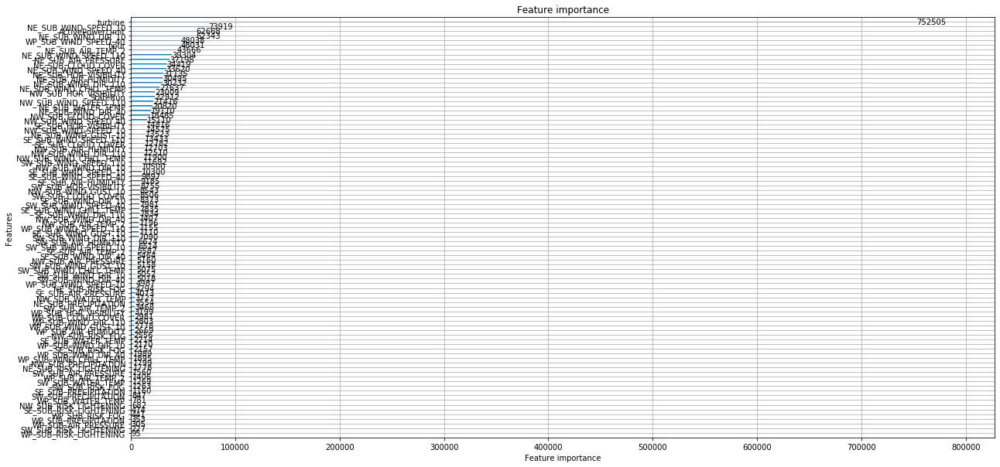

In [0]:
lgb.plot_importance(bst, figsize=(20, 10))

In [0]:
plan_df = pd.merge(plan, start_times, on="timestamp", how="left")
plan_df.sort_values("timestamp", inplace=True)
plan_df.set_index("timestamp", inplace=True)

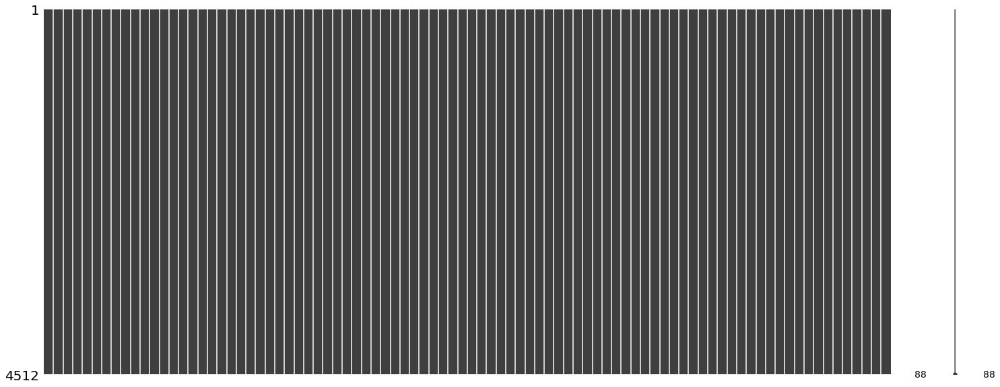

In [0]:
msn.matrix(plan_df)

In [0]:
# !pip install pytz
from datetime import datetime, timedelta
import pytz

start = pd.to_datetime("2019-4-23").tz_localize('utc')

plan_X, _ = build_dataset(plan_df[start: start + timedelta(hours=47)], labels=False)

In [0]:


fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Scatter(
      x=list(range(len(plan_X.values))),
      y=bst.predict(plan_X.values),
    name='Predicted',
  ),
)

fig.add_trace(go.Scatter(
    x=list(range(len(plan_X.values))),
    y=plan_X.values[:,3],
   name='Wind 10',
),
secondary_y=True)
fig.add_trace(go.Scatter(
    x=list(range(len(plan_X.values))),
    y=plan_X.values[:,4],
   name='Wind 40',
),
secondary_y=True)
fig.add_trace(go.Scatter(
    x=list(range(len(plan_X.values))),
    y=plan_X.values[:,5],
   name='Wind 110',
),
secondary_y=True)
fig.show()

In [0]:
submission = plan_X.copy()
submission["energy"] = bst.predict(plan_X)
submission

,turbine,ActivePowerLimit,StateRun,NE_SUB_WIND_SPEED_10,NE_SUB_WIND_SPEED_40,NE_SUB_WIND_SPEED_110,NE_SUB_WIND_GUST_10,NE_SUB_WIND_DIR_10,NE_SUB_WIND_DIR_40,NE_SUB_WIND_DIR_110,NE_SUB_AIR_TEMP_2,NE_SUB_AIR_PRESSURE,NE_SUB_AIR_HUMIDITY,NE_SUB_WIND_CHILL_TEMP,NE_SUB_WATER_TEMP,NE_SUB_HOR_VISIBILITY,NE_SUB_CLOUD_COVER,NE_SUB_PRECIPITATION,NE_SUB_RISK_LIGHTENING,NE_SUB_RISK_FOG,NW_SUB_WIND_SPEED_10,NW_SUB_WIND_SPEED_40,NW_SUB_WIND_SPEED_110,NW_SUB_WIND_GUST_10,NW_SUB_WIND_DIR_10,NW_SUB_WIND_DIR_40,NW_SUB_WIND_DIR_110,NW_SUB_AIR_TEMP_2,NW_SUB_AIR_PRESSURE,NW_SUB_AIR_HUMIDITY,NW_SUB_WIND_CHILL_TEMP,NW_SUB_WATER_TEMP,NW_SUB_HOR_VISIBILITY,NW_SUB_CLOUD_COVER,NW_SUB_PRECIPITATION,NW_SUB_RISK_LIGHTENING,NW_SUB_RISK_FOG,SE_SUB_WIND_SPEED_10,SE_SUB_WIND_SPEED_40,SE_SUB_WIND_SPEED_110,...,SE_SUB_CLOUD_COVER,SE_SUB_PRECIPITATION,SE_SUB_RISK_LIGHTENING,SE_SUB_RISK_FOG,SW_SUB_WIND_SPEED_10,SW_SUB_WIND_SPEED_40,SW_SUB_WIND_SPEED_110,SW_SUB_WIND_GUST_10,SW_SUB_WIND_DIR_10,SW_SUB_WIND_DIR_40,SW_SUB_WIND_DIR_110,SW_SUB_AIR_TEMP_2,SW_SUB_AIR_PRESSURE,SW_SUB_AIR_HUMIDITY,SW_SUB_WIND_CHILL_TEMP,SW_SUB_WATER_TEMP,SW_SUB_HOR_VISIBILITY,SW_SUB_CLOUD_COVER,SW_SUB_PRECIPITATION,SW_SUB_RISK_LIGHTENING,SW_SUB_RISK_FOG,WP_SUB_WIND_SPEED_10,WP_SUB_WIND_SPEED_40,WP_SUB_WIND_SPEED_110,WP_SUB_WIND_GUST_10,WP_SUB_WIND_DIR_10,WP_SUB_WIND_DIR_40,WP_SUB_WIND_DIR_110,WP_SUB_AIR_TEMP_2,WP_SUB_AIR_PRESSURE,WP_SUB_AIR_HUMIDITY,WP_SUB_WIND_CHILL_TEMP,WP_SUB_WATER_TEMP,WP_SUB_HOR_VISIBILITY,WP_SUB_CLOUD_COVER,WP_SUB_PRECIPITATION,WP_SUB_RISK_LIGHTENING,WP_SUB_RISK_FOG,hour,energy
timestamp,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2019-04-23 00:00:00+00:00,0,4000.0,1.0,9.3,9.9,11.3,12.6,304.0,305.0,310.0,12.1,1.022,88.0,2.6,13.7,80.001,29.0,0.0,0.0,0.0,9.2,9.8,11.3,12.4,303.0,304.0,310.0,12.0,1.022,88.0,2.6,13.5,78.848,29.0,0.0,0.0,0.0,9.3,9.8,11.3,...,27.0,0.0,0.0,0.0,9.2,9.7,11.2,12.4,302.0,304.0,309.0,11.9,1.022,88.0,2.4,13.5,77.603,27.0,0.0,0.0,0.0,9.3,9.4,11.3,12.5,303.0,304.0,310.0,12.0,1.022,88.0,2.5,13.6,79.122,26.0,0.0,0.0,0.0,0,2835.169424
2019-04-23 00:00:00+00:00,1,4000.0,1.0,9.3,9.9,11.3,12.6,304.0,305.0,310.0,12.1,1.022,88.0,2.6,13.7,80.001,29.0,0.0,0.0,0.0,9.2,9.8,11.3,12.4,303.0,304.0,310.0,12.0,1.022,88.0,2.6,13.5,78.848,29.0,0.0,0.0,0.0,9.3,9.8,11.3,...,27.0,0.0,0.0,0.0,9.2,9.7,11.2,12.4,302.0,304.0,309.0,11.9,1.022,88.0,2.4,13.5,77.603,27.0,0.0,0.0,0.0,9.3,9.4,11.3,12.5,303.0,304.0,310.0,12.0,1.022,88.0,2.5,13.6,79.122,26.0,0.0,0.0,0.0,0,2777.466108
2019-04-23 00:00:00+00:00,2,4000.0,1.0,9.3,9.9,11.3,12.6,304.0,305.0,310.0,12.1,1.022,88.0,2.6,13.7,80.001,29.0,0.0,0.0,0.0,9.2,9.8,11.3,12.4,303.0,304.0,310.0,12.0,1.022,88.0,2.6,13.5,78.848,29.0,0.0,0.0,0.0,9.3,9.8,11.3,...,27.0,0.0,0.0,0.0,9.2,9.7,11.2,12.4,302.0,304.0,309.0,11.9,1.022,88.0,2.4,13.5,77.603,27.0,0.0,0.0,0.0,9.3,9.4,11.3,12.5,303.0,304.0,310.0,12.0,1.022,88.0,2.5,13.6,79.122,26.0,0.0,0.0,0.0,0,2717.048656
2019-04-23 00:00:00+00:00,3,4000.0,1.0,9.3,9.9,11.3,12.6,304.0,305.0,310.0,12.1,1.022,88.0,2.6,13.7,80.001,29.0,0.0,0.0,0.0,9.2,9.8,11.3,12.4,303.0,304.0,310.0,12.0,1.022,88.0,2.6,13.5,78.848,29.0,0.0,0.0,0.0,9.3,9.8,11.3,...,27.0,0.0,0.0,0.0,9.2,9.7,11.2,12.4,302.0,304.0,309.0,11.9,1.022,88.0,2.4,13.5,77.603,27.0,0.0,0.0,0.0,9.3,9.4,11.3,12.5,303.0,304.0,310.0,12.0,1.022,88.0,2.5,13.6,79.122,26.0,0.0,0.0,0.0,0,2742.751872
2019-04-23 00:00:00+00:00,4,4000.0,1.0,9.3,9.9,11.3,12.6,304.0,305.0,310.0,12.1,1.022,88.0,2.6,13.7,80.001,29.0,0.0,0.0,0.0,9.2,9.8,11.3,12.4,303.0,304.0,310.0,12.0,1.022,88.0,2.6,13.5,78.848,29.0,0.0,0.0,0.0,9.3,9.8,11.3,...,27.0,0.0,0.0,0.0,9.2,9.7,11.2,12.4,302.0,304.0,309.0,11.9,1.022,88.0,2.4,13.5,77.603,27.0,0.0,0.0,0.0,9.3,9.4,11.3,12.5,303.0,304.0,310.0,12.0,1.022,88.0,2.5,13.6,79.122,26.0,0.0,0.0,0.0,0,2667.634870
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

In [0]:
submission = submission[["energy"]].groupby("timestamp").sum()
submission["energy"] = submission["energy"].astype(int)

In [0]:
submission.to_csv("submission.csv", sep=";")